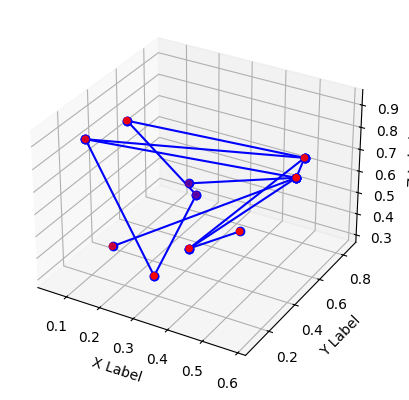

In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import networkx as nx
import numpy as np

# Create a simple graph
G = nx.erdos_renyi_graph(10, 0.3)  # Example random graph with 10 nodes and a 30% edge probability

# Generate 3D positions for each node (for example using random values)
pos = {node: np.random.rand(3) for node in G.nodes()}

# Create the plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Draw the edges
for edge in G.edges():
    x = np.array([pos[edge[0]][0], pos[edge[1]][0]])
    y = np.array([pos[edge[0]][1], pos[edge[1]][1]])
    z = np.array([pos[edge[0]][2], pos[edge[1]][2]])
    ax.plot(x, y, z, c='b', marker='o')

# Draw the nodes
x_nodes = [pos[node][0] for node in G.nodes()]
y_nodes = [pos[node][1] for node in G.nodes()]
z_nodes = [pos[node][2] for node in G.nodes()]
ax.scatter(x_nodes, y_nodes, z_nodes, c='r', marker='o')

# Set labels (optional)
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Show the plot
plt.show()


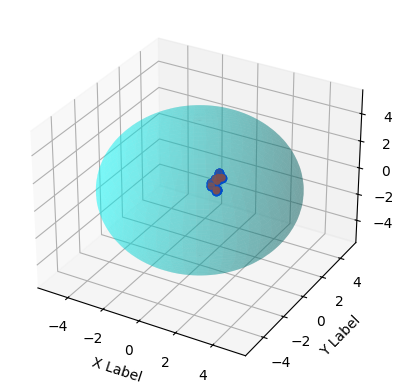

In [2]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import networkx as nx
import numpy as np
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Create a simple graph
G = nx.erdos_renyi_graph(10, 0.3)

# Generate 3D positions for each node (random positions)
pos = {node: np.random.rand(3) for node in G.nodes()}

# Create the plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Draw the edges of the graph
for edge in G.edges():
    x = np.array([pos[edge[0]][0], pos[edge[1]][0]])
    y = np.array([pos[edge[0]][1], pos[edge[1]][1]])
    z = np.array([pos[edge[0]][2], pos[edge[1]][2]])
    ax.plot(x, y, z, c='b', marker='o')

# Draw the nodes
x_nodes = [pos[node][0] for node in G.nodes()]
y_nodes = [pos[node][1] for node in G.nodes()]
z_nodes = [pos[node][2] for node in G.nodes()]
ax.scatter(x_nodes, y_nodes, z_nodes, c='r', marker='o')

# Add a spherical 'brain' (just an example shape) to represent a brain
# Here, we'll create a sphere as a simple "brain" representation
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x = 5 * np.outer(np.cos(u), np.sin(v))  # Radius of the sphere is 5
y = 5 * np.outer(np.sin(u), np.sin(v))
z = 5 * np.outer(np.ones(np.size(u)), np.cos(v))

# Plot the 'brain' sphere with transparent surface
ax.plot_surface(x, y, z, color='cyan', alpha=0.3)

# Set labels
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Show the plot
plt.show()


In [11]:
detailed_brain_stl = "../../data/stl/brain_20human_NIH3D_detailed.stl"
less_detailed_brain_stl = "../../data/stl/human_brain_NIH3D_less_detailed.stl"

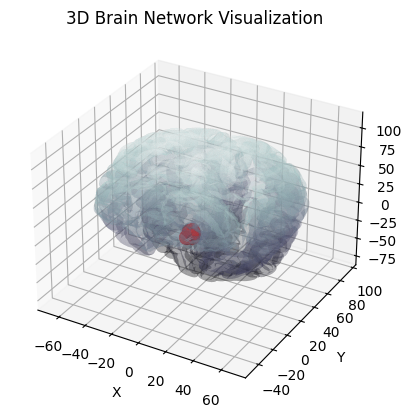

In [10]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import networkx as nx
import numpy as np
import trimesh
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Load the brain STL model
detailed_brain_stl = "../../data/stl/brain_20human_NIH3D_detailed.stl"
less_detailed_brain_stl = "../../data/stl/human_brain_NIH3D_less_detailed.stl"
brain_mesh = trimesh.load_mesh(detailed_brain_stl)

# Example brain regions (nodes)
regions = ['Region A', 'Region B', 'Region C', 'Region D', 'Region E']
num_regions = len(regions)

# Example connectivity matrix (correlations/weights between brain regions)
# This should be a square matrix of size num_regions x num_regions
connectivity_matrix = np.random.rand(num_regions, num_regions)

# Create a networkx graph
G = nx.Graph()

# Add nodes
for region in regions:
    G.add_node(region)

# Add edges based on the connectivity matrix (add weights as edge attributes)
for i in range(num_regions):
    for j in range(i+1, num_regions):
        if connectivity_matrix[i, j] > 0:  # Only consider non-zero connections
            G.add_edge(regions[i], regions[j], weight=connectivity_matrix[i, j])

# Define 3D positions for each node (for simplicity, we assign random positions)
# Ideally, you should use anatomical 3D coordinates (from neuroimaging data)
positions = {region: np.random.rand(3) * 10 for region in regions}

# 3D Plotting of the network over the brain mesh
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the brain mesh
ax.plot_trisurf(brain_mesh.vertices[:, 0], brain_mesh.vertices[:, 1], brain_mesh.vertices[:, 2], triangles=brain_mesh.faces, cmap='bone', alpha=0.2)

# Draw the edges based on the connectivity matrix
for edge in G.edges():
    node1, node2 = edge
    x1, y1, z1 = positions[node1]
    x2, y2, z2 = positions[node2]
    
    # Get the weight (color/size based on correlation strength)
    weight = G[node1][node2]['weight']
    
    # Adjust color based on weight
    color = plt.cm.viridis(weight)
    
    # Adjust line thickness based on weight (for visual emphasis)
    thickness = weight * 2  # Adjust as needed for better visualization
    
    # Plot the edge as a line in 3D space
    ax.plot([x1, x2], [y1, y2], [z1, z2], color=color, linewidth=thickness)

# Plot the nodes (regions)
for region, pos in positions.items():
    ax.scatter(pos[0], pos[1], pos[2], color='r', s=100, label=region)

# Set labels and title
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('3D Brain Network Visualization')

# Show the plot
plt.show()


In [14]:
import networkx as nx
import numpy as np
import plotly.graph_objects as go
import trimesh

# Load the brain STL model
brain_mesh = trimesh.load_mesh(detailed_brain_stl)

# Example brain regions (nodes)
regions = ['Region A', 'Region B', 'Region C', 'Region D', 'Region E']
num_regions = len(regions)

# Example connectivity matrix (correlations/weights between brain regions)
connectivity_matrix = np.random.rand(num_regions, num_regions)

# Create a networkx graph
G = nx.Graph()

# Add nodes
for region in regions:
    G.add_node(region)

# Add edges based on the connectivity matrix (add weights as edge attributes)
for i in range(num_regions):
    for j in range(i+1, num_regions):
        if connectivity_matrix[i, j] > 0:  # Only consider non-zero connections
            G.add_edge(regions[i], regions[j], weight=connectivity_matrix[i, j])

# Define 3D positions for each node (for simplicity, we assign random positions)
# Ideally, you should use anatomical 3D coordinates (from neuroimaging data)
positions = {region: np.random.rand(3) * 10 for region in regions}

# Extract the X, Y, Z coordinates of the nodes
x_vals = [positions[region][0] for region in regions]
y_vals = [positions[region][1] for region in regions]
z_vals = [positions[region][2] for region in regions]

# Create Plotly 3D scatter plot for nodes
node_trace = go.Scatter3d(
    x=x_vals, y=y_vals, z=z_vals,
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        opacity=0.8
    ),
    text=regions,
    hoverinfo='text'
)

# Create Plotly 3D line plot for edges (using edge positions)
edge_x = []
edge_y = []
edge_z = []
for node1, node2 in G.edges():
    x1, y1, z1 = positions[node1]
    x2, y2, z2 = positions[node2]
    
    edge_x += [x1, x2, None]
    edge_y += [y1, y2, None]
    edge_z += [z1, z2, None]

edge_trace = go.Scatter3d(
    x=edge_x, y=edge_y, z=edge_z,
    mode='lines',
    line=dict(
        width=2,
        color='blue'
    ),
)

# Create the figure with the brain model and network
fig = go.Figure(data=[node_trace, edge_trace])

# Add 3D brain STL model (optional step to overlay the brain model)
fig.add_trace(go.Mesh3d(
    x=brain_mesh.vertices[:, 0],
    y=brain_mesh.vertices[:, 1],
    z=brain_mesh.vertices[:, 2],
    opacity=0.2,
    color='lightgray',
))

# Set the layout to make it interactive
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        aspectmode='cube',
    ),
    title='Interactive 3D Brain Network',
    margin=dict(l=0, r=0, b=0, t=40),
)

# Show the interactive plot
fig.show()


In [22]:
import networkx as nx
import numpy as np
import plotly.graph_objects as go
import trimesh

# Load the brain STL model
brain_mesh = trimesh.load_mesh(detailed_brain_stl)

# Example brain regions (nodes)
regions = ['Region A', 'Region B', 'Region C', 'Region D', 'Region E']
num_regions = len(regions)

# Example connectivity matrix (correlations/weights between brain regions)
connectivity_matrix = np.random.rand(num_regions, num_regions)

# Create a networkx graph
G = nx.Graph()

# Add nodes
for region in regions:
    G.add_node(region)

# Add edges based on the connectivity matrix (add weights as edge attributes)
for i in range(num_regions):
    for j in range(i+1, num_regions):
        if connectivity_matrix[i, j] > 0:  # Only consider non-zero connections
            G.add_edge(regions[i], regions[j], weight=connectivity_matrix[i, j])

# Define 3D positions for each node (for simplicity, we assign random positions)
# Ideally, you should use anatomical 3D coordinates (from neuroimaging data)
positions = {region: np.random.rand(3) * 10 for region in regions}

# Extract the X, Y, Z coordinates of the nodes
x_vals = [positions[region][0] for region in regions]
y_vals = [positions[region][1] for region in regions]
z_vals = [positions[region][2] for region in regions]

# Create Plotly 3D scatter plot for nodes
node_trace = go.Scatter3d(
    x=x_vals, y=y_vals, z=z_vals,
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        opacity=0.8
    ),
    text=regions,
    hoverinfo='text'
)

# Create Plotly 3D line plot for edges (using edge positions)
edge_x = []
edge_y = []
edge_z = []
for node1, node2 in G.edges():
    x1, y1, z1 = positions[node1]
    x2, y2, z2 = positions[node2]
    
    edge_x += [x1, x2, None]
    edge_y += [y1, y2, None]
    edge_z += [z1, z2, None]

edge_trace = go.Scatter3d(
    x=edge_x, y=edge_y, z=edge_z,
    mode='lines',
    line=dict(
        width=2,
        color='blue'
    ),
)

# Create the figure with the brain model and network
fig = go.Figure(data=[node_trace, edge_trace])

# Add 3D wireframe of the brain model (overlay the brain model as transparent wireframe)
fig.add_trace(go.Mesh3d(
    x=brain_mesh.vertices[:, 0],
    y=brain_mesh.vertices[:, 1],
    z=brain_mesh.vertices[:, 2],
    opacity=0.1,  # Transparency for the wireframe
    color='lightgray',
    showscale=False,
    i=brain_mesh.faces[:, 0],
    j=brain_mesh.faces[:, 1],
    k=brain_mesh.faces[:, 2],
    # opacity=0.2,  # Adjust this to make the wireframe more or less transparent
))

# Set the layout to make it interactive
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        aspectmode='cube',
    ),
    title='Interactive 3D Brain Network',
    margin=dict(l=0, r=0, b=0, t=40),
)

# Show the interactive plot
fig.show()


In [29]:
import networkx as nx
import numpy as np
import plotly.graph_objects as go
import trimesh

# Load the brain STL model
brain_mesh = trimesh.load_mesh(detailed_brain_stl)

# Example brain regions (nodes)
regions = ['Region A', 'Region B', 'Region C', 'Region D', 'Region E']
num_regions = len(regions)

# Example connectivity matrix (correlations/weights between brain regions)
connectivity_matrix = np.random.rand(num_regions, num_regions)

# Create a networkx graph
G = nx.Graph()

# Add nodes
for region in regions:
    G.add_node(region)

# Add edges based on the connectivity matrix (add weights as edge attributes)
for i in range(num_regions):
    for j in range(i+1, num_regions):
        if connectivity_matrix[i, j] > 0:  # Only consider non-zero connections
            G.add_edge(regions[i], regions[j], weight=connectivity_matrix[i, j])

# Define 3D positions for each node (for simplicity, we assign random positions)
# Ideally, you should use anatomical 3D coordinates (from neuroimaging data)
positions = {region: np.random.rand(3) * 10 for region in regions}

# Extract the X, Y, Z coordinates of the nodes
x_vals = [positions[region][0] for region in regions]
y_vals = [positions[region][1] for region in regions]
z_vals = [positions[region][2] for region in regions]

# Create Plotly 3D scatter plot for nodes
node_trace = go.Scatter3d(
    x=x_vals, y=y_vals, z=z_vals,
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        opacity=0.8
    ),
    text=regions,
    hoverinfo='text'
)

# Create Plotly 3D line plot for edges (using edge positions)
edge_x = []
edge_y = []
edge_z = []
for node1, node2 in G.edges():
    x1, y1, z1 = positions[node1]
    x2, y2, z2 = positions[node2]
    
    edge_x += [x1, x2, None]
    edge_y += [y1, y2, None]
    edge_z += [z1, z2, None]

edge_trace = go.Scatter3d(
    x=edge_x, y=edge_y, z=edge_z,
    mode='lines',
    line=dict(
        width=2,
        color='blue'
    ),
    hoverinfo='text'  # Disable hover for edges
)

# Create the figure with the brain model and network
fig = go.Figure(data=[node_trace, edge_trace])

# Add 3D wireframe of the brain model (overlay the brain model as transparent wireframe)
fig.add_trace(go.Mesh3d(
    x=brain_mesh.vertices[:, 0],
    y=brain_mesh.vertices[:, 1],
    z=brain_mesh.vertices[:, 2],
    opacity=0.1,  # Transparency for the wireframe
    color='lightgray',
    showscale=False,
    i=brain_mesh.faces[:, 0],
    j=brain_mesh.faces[:, 1],
    k=brain_mesh.faces[:, 2],
    hoverinfo='none'  # Disable hover for the brain mesh
))

# Set the layout to make it interactive
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        aspectmode='cube',
    ),
    title='Interactive 3D Brain Network',
    margin=dict(l=0, r=0, b=0, t=40),
)

# Show the interactive plot
fig.show()


In [40]:

import networkx as nx
import numpy as np
import plotly.graph_objects as go
import trimesh

# Load the brain STL model
brain_mesh = trimesh.load_mesh(detailed_brain_stl)

# Example brain regions (nodes)
regions = ['Region A', 'Region B', 'Region C', 'Region D', 'Region E']
num_regions = len(regions)

# Example connectivity matrix (correlations/weights between brain regions)
connectivity_matrix = np.random.rand(num_regions, num_regions)

# Create a networkx graph
G = nx.Graph()

# Add nodes
for region in regions:
    G.add_node(region)

# Add edges based on the connectivity matrix (add weights as edge attributes)
for i in range(num_regions):
    for j in range(i+1, num_regions):
        if connectivity_matrix[i, j] > 0:  # Only consider non-zero connections
            G.add_edge(regions[i], regions[j], weight=connectivity_matrix[i, j])

# Define 3D positions for each node (for simplicity, we assign random positions)
# Ideally, you should use anatomical 3D coordinates (from neuroimaging data)
positions = {region: np.random.rand(3) * 10 for region in regions}

# Extract the X, Y, Z coordinates of the nodes
x_vals = [positions[region][0] for region in regions]
y_vals = [positions[region][1] for region in regions]
z_vals = [positions[region][2] for region in regions]

# Create Plotly 3D scatter plot for nodes
node_trace = go.Scatter3d(
    x=x_vals, y=y_vals, z=z_vals,
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        opacity=0.8
    ),
    text=regions,
    hoverinfo='text'
)

# Create Plotly 3D line plot for edges (using edge positions)
edge_x = []
edge_y = []
edge_z = []
for node1, node2 in G.edges():
    x1, y1, z1 = positions[node1]
    x2, y2, z2 = positions[node2]
    
    edge_x += [x1, x2, None]
    edge_y += [y1, y2, None]
    edge_z += [z1, z2, None]

edge_trace = go.Scatter3d(
    x=edge_x, y=edge_y, z=edge_z,
    mode='lines',
    line=dict(
        width=2,
        color='blue'
    ),
    hoverinfo='none'  # Disable hover for edges
)

# # Define the rotation matrix for 90 degrees about the Y-axis
# theta = np.radians(90)  # Convert 90 degrees to radians
# rotation_matrix = np.array([
#     [np.cos(theta), 0, np.sin(theta)],
#     [0, 1, 0],
#     [-np.sin(theta), 0, np.cos(theta)]
# ])

# # Apply the rotation to the brain mesh vertices
# rotated_vertices = brain_mesh.vertices.dot(rotation_matrix.T)

# # Create the figure with the brain model and network
# fig = go.Figure(data=[node_trace, edge_trace])

# # Add rotated 3D wireframe of the brain model (overlay the rotated brain model as transparent wireframe)
# fig.add_trace(go.Mesh3d(
#     x=rotated_vertices[:, 0],
#     y=rotated_vertices[:, 1],
#     z=rotated_vertices[:, 2],
#     opacity=0.1,  # Transparency for the wireframe
#     color='lightgray',
#     showscale=False,
#     i=brain_mesh.faces[:, 0],
#     j=brain_mesh.faces[:, 1],
#     k=brain_mesh.faces[:, 2],
#     hoverinfo='none'  # Disable hover for the brain mesh
# ))

# # Set the layout to make it interactive
# fig.update_layout(
#     scene=dict(
#         xaxis=dict(title='X'),
#         yaxis=dict(title='Y'),
#         zaxis=dict(title='Z'),
#         aspectmode='cube',
#     ),
#     title='Interactive 3D Brain Network',
#     margin=dict(l=0, r=0, b=0, t=40),
# )


# Define the rotation matrix for 90 degrees about the X-axis
theta = np.radians(90)  # Convert 90 degrees to radians
rotation_matrix_x = np.array([
    [1, 0, 0],
    [0, np.cos(theta), -np.sin(theta)],
    [0, np.sin(theta), np.cos(theta)]
])

# Apply the rotation to the brain mesh vertices (around x-axis)
rotated_vertices_x = brain_mesh.vertices.dot(rotation_matrix_x.T)

# Create the figure with the rotated brain mesh along with the network
fig = go.Figure(data=[node_trace, edge_trace])

# Add rotated 3D wireframe of the brain model (overlay the rotated brain model as transparent wireframe)
fig.add_trace(go.Mesh3d(
    x=rotated_vertices_x[:, 0],
    y=rotated_vertices_x[:, 1],
    z=rotated_vertices_x[:, 2],
    opacity=0.1,  # Transparency for the wireframe
    color='lightpink',
    showscale=False,
    i=brain_mesh.faces[:, 0],
    j=brain_mesh.faces[:, 1],
    k=brain_mesh.faces[:, 2],
    hoverinfo='none'  # Disable hover for the brain mesh
))

# Set the layout to make it interactive
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        aspectmode='cube',
    ),
    title='Interactive 3D Brain Network',
    margin=dict(l=0, r=0, b=0, t=40),
)

# Show the interactive plot
fig.show()